Copyright (c) 2021 Python Charmers. All rights reserved. Please do not distribute.

# Day 3 - Python for Predictive Data Analytics - 2021-11-24

## Feedback please

- Ben Madeley @ Shell Brisbane: push for digitalization in the industry. Has seen the advantages .

- Elmer Phan: CBUS: investment operations analyst. Really good. Errol really good, knowledgeable and structured. 

- Pragathi: pretty good yesterday.


#### Q: How is your knowledge level of probability / statistics?

- Not much
- Done it but rusty
- Remember 1st year undergrad
- Beyond that

## Time-series

Pandas is the best tool for working with time-series data in Python.

In [4]:
import pandas as pd

apple = pd.read_hdf('/Data/AAPL.h5')
apple[:3]

,Open,High,Low,Close,Volume,Adj Close
Date,,,,,,
2000-01-03,104.87,112.50,101.69,111.94,19144400,27.74
2000-01-04,108.25,110.62,101.19,102.50,18310000,25.40
2000-01-05,103.75,110.56,103.00,104.00,27818000,25.77


In [6]:
2**64

18446744073709551616

In [5]:
apple.index

DatetimeIndex(['2000-01-03', '2000-01-04', '2000-01-05', '2000-01-06',
               '2000-01-07', '2000-01-10', '2000-01-11', '2000-01-12',
               '2000-01-13', '2000-01-14',
               ...
               '2012-12-05', '2012-12-06', '2012-12-07', '2012-12-10',
               '2012-12-11', '2012-12-12', '2012-12-13', '2012-12-14',
               '2012-12-17', '2012-12-18'],
              dtype='datetime64[ns]', name='Date', length=3261, freq=None)

In [13]:
apple.loc['2008']

,Open,High,Low,Close,Volume,Adj Close
Date,,,,,,
2008-01-02,199.27,200.26,192.55,194.84,38542100,193.12
2008-01-03,195.41,197.39,192.69,194.93,30073800,193.21
2008-01-04,191.45,193.00,178.89,180.05,51994000,178.47
2008-01-07,181.25,183.60,170.23,177.64,74006900,176.08
2008-01-08,180.14,182.46,170.80,171.25,54422000,169.74
...,...,...,...,...,...,...
2008-12-24,86.14,86.25,84.55,85.04,9690500,84.29
2008-12-26,86.64,87.42,85.24,85.81,11011600,85.05
2008-12-29,86.52,87.62,85.07,86.61,24500000,85.85


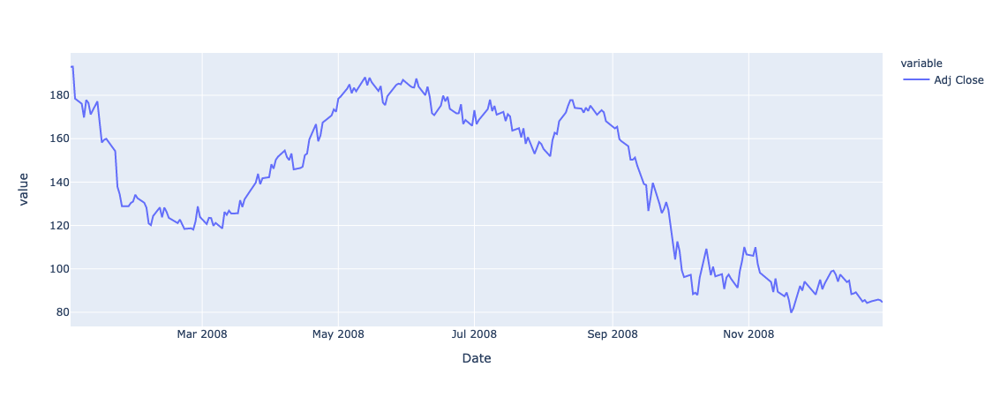

In [14]:
import plotly.express as px

px.line(apple.loc['2008', 'Adj Close'])

In [8]:
apple.loc['2000-01']
# Equivalent to this:
# apple.loc['2000-01-01':'2000-01-31']

,Open,High,Low,Close,Volume,Adj Close
Date,,,,,,
2000-01-03,104.87,112.50,101.69,111.94,19144400,27.74
2000-01-04,108.25,110.62,101.19,102.50,18310000,25.40
2000-01-05,103.75,110.56,103.00,104.00,27818000,25.77
2000-01-06,106.12,107.00,95.00,95.00,27443200,23.54
2000-01-07,96.50,101.00,95.50,99.50,16463200,24.66
2000-01-10,102.00,102.25,94.75,97.75,18059200,24.22
2000-01-11,95.94,99.37,90.50,92.75,15775200,22.98
2000-01-12,95.00,95.50,86.50,87.19,34870800,21.61
2000-01-13,94.48,98.75,92.50,96.75,36882400,23.97


### Resampling

Equivalent to the pivot table / groupby functionality but for time series: `resample`

#### Question: what was the total trading volume for Apple each year?

In [17]:
apple['Volume'].resample('A').sum()    # 'A' means annual

Date
2000-12-31     4298582600
2001-12-31     3380921000
2002-12-31     2750497400
2003-12-31     2543937600
2004-12-31     4350059600
2005-12-31     6514321000
2006-12-31     7703477400
2007-12-31     8820760200
2008-12-31    10213471500
2009-12-31     5116040000
2010-12-31     5393747400
2011-12-31     4430740100
2012-12-31     4588894400
Freq: A-DEC, Name: Volume, dtype: int64

### Exercise: calculate the average Close price for Apple each month

Hint: use the code 'M' for monthly when you call resample.

In [21]:
monthly_averages = apple['Close'].resample('M').mean()        # 'M' means monthly
monthly_averages[:3]

Date
2000-01-31    103.359500
2000-02-29    111.636000
2000-03-31    128.502609
Freq: M, Name: Close, dtype: float64

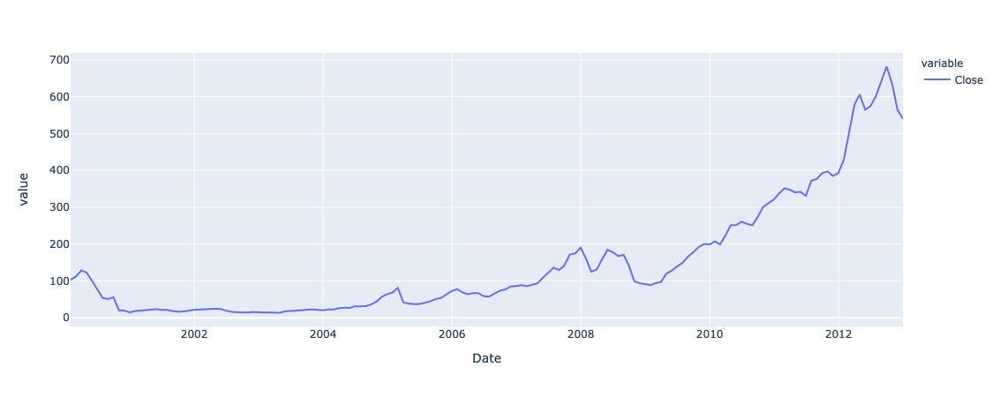

In [20]:
px.line(monthly_averages)

In [22]:
apple['Volume'].resample('Q').sum()   # every quarter: Jan-Mar, Apr-June etc.

Date
2000-03-31    1021170800
2000-06-30     949761600
2000-09-30     925382600
2000-12-31    1402267600
2001-03-31    1126438600
2001-06-30     938060400
2001-09-30     689856600
2001-12-31     626565400
2002-03-31     773978000
2002-06-30     753821800
2002-09-30     662926400
2002-12-31     559771200
2003-03-31     506733600
2003-06-30     882150800
2003-09-30     531190000
2003-12-31     623863200
2004-03-31     874141000
2004-06-30     802203000
2004-09-30     906480400
2004-12-31    1767235200
2005-03-31    2208325400
2005-06-30    1555750300
2005-09-30    1137243700
2005-12-31    1613001600
2006-03-31    2279646500
2006-06-30    1916595900
2006-09-30    1896033800
2006-12-31    1611201200
2007-03-31    2030385000
2007-06-30    1932298200
2007-09-30    2475378400
2007-12-31    2382698600
2008-03-31    2963111300
2008-06-30    2173154000
2008-09-30    2032252800
2008-12-31    3044953400
2009-03-31    1692615100
2009-06-30    1212657000
2009-09-30    1039163600
2009-12-31    117160

In [23]:
apple['Volume'].resample('A-JUN').sum()   # every Australian financial year (ending June)

Date
2000-06-30    1970932400
2001-06-30    4392149200
2002-06-30    2844221800
2003-06-30    2611582000
2004-06-30    2831397200
2005-06-30    6437791300
2006-06-30    6946487700
2007-06-30    7469918200
2008-06-30    9994342300
2009-06-30    7982478300
2010-06-30    5253635200
2011-06-30    4382089700
2012-06-30    4841455800
2013-06-30    2146969100
Freq: A-JUN, Name: Volume, dtype: int64

In [24]:
apple['Close'].resample('3W-WED').mean()   # every 3 weeks ending on Wednesdays

Date
2000-01-05    106.146667
2000-01-26    102.384286
2000-02-16    109.231333
2000-03-08    118.606429
2000-03-29    129.542000
                 ...    
2012-10-10    666.879333
2012-10-31    623.271538
2012-11-21    556.524667
2012-12-12    563.922857
2013-01-02    523.052500
Freq: 3W-WED, Name: Close, Length: 227, dtype: float64

### Differences across time

#### Example 1: the absolute change in value from one row to the next

In [25]:
apple['Close'].diff()

Date
2000-01-03      NaN
2000-01-04    -9.44
2000-01-05     1.50
2000-01-06    -9.00
2000-01-07     4.50
              ...  
2012-12-12    -2.39
2012-12-13    -9.31
2012-12-14   -19.90
2012-12-17     9.04
2012-12-18    15.07
Name: Close, Length: 3261, dtype: float64

#### Example 2: the relative change in value from one row to the next

In [26]:
apple['Close'].pct_change()

Date
2000-01-03         NaN
2000-01-04   -0.084331
2000-01-05    0.014634
2000-01-06   -0.086538
2000-01-07    0.047368
                ...   
2012-12-12   -0.004415
2012-12-13   -0.017273
2012-12-14   -0.037569
2012-12-17    0.017733
2012-12-18    0.029046
Name: Close, Length: 3261, dtype: float64

### Example 3: Find the day with the steepest % drop in price, and how much it dropped in % terms

In [29]:
apple['Close'].pct_change().min()

-0.5186915887850467

In [30]:
apple['Close'].pct_change().idxmin()

Timestamp('2000-09-29 00:00:00')

In [31]:
apple['Close'].pct_change().nsmallest(1)

Date
2000-09-29   -0.518692
Name: Close, dtype: float64

### Exercise: Examining Apple's stock over time

Looking at Apple's stock data, answer the following questions:

1. ~Calculate the total trading volume for each year.~
2. Between year 2005 (inclusive) and 2010 (inclusive), calculate the maximum increase between the opening price and the closing price in a single day. Which date had the maximum difference?
3. Calculate the maximum increase of the adjusted closing price in a year. Which year had the maximum rise?
4. For each month, what was the worst trading day, defined as the maximum drop in closing price from the previous day's level?
5. **Challenge:** For each year, what were the "best" 3 trading days (defined based on the % increase from Open to Close the same day)?

In [32]:
# Hint for part 3:
apple['Adj Close'].resample('A').last()

Date
2000-12-31      7.37
2001-12-31     10.85
2002-12-31      7.10
2003-12-31     10.59
2004-12-31     31.92
2005-12-31     71.26
2006-12-31     84.09
2007-12-31    196.34
2008-12-31     84.60
2009-12-31    208.88
2010-12-31    319.72
2011-12-31    401.44
2012-12-31    533.90
Freq: A-DEC, Name: Adj Close, dtype: float64

### Solutions

#### Q2:

In [38]:
subset = apple.loc['2005':'2010'].copy()
subset['Jump'] = subset['Close'] - subset['Open']

In [40]:
subset['Jump'].max()

13.02000000000001

In [41]:
subset['Jump'].idxmax()

Timestamp('2008-07-22 00:00:00')

#### Q3:

In [45]:
final_day_close_each_year = apple['Adj Close'].resample('A').last()

In [48]:
final_day_close_each_year.diff().idxmax()

Timestamp('2012-12-31 00:00:00', freq='A-DEC')

#### Q4:

In [50]:
day_on_day_changes = apple['Close'].diff()

In [52]:
day_on_day_changes.resample('M').min()

Date
2000-01-31    -9.44
2000-02-29    -4.88
2000-03-31   -10.19
2000-04-30   -10.19
2000-05-31    -6.75
              ...  
2012-08-31    -9.60
2012-09-30   -17.70
2012-10-31   -22.80
2012-11-30   -24.85
2012-12-31   -37.06
Freq: M, Name: Close, Length: 156, dtype: float64

In [57]:
apple.diff().resample('M')['Close'].idxmin()

Date
2000-01-31   2000-01-04
2000-02-29   2000-02-16
2000-03-31   2000-03-30
2000-04-30   2000-04-12
2000-05-31   2000-05-19
                ...    
2012-08-31   2012-08-30
2012-09-30   2012-09-10
2012-10-31   2012-10-19
2012-11-30   2012-11-07
2012-12-31   2012-12-05
Freq: M, Name: Close, Length: 156, dtype: datetime64[ns]

In [58]:
apple.diff().resample('M')['Close'].nsmallest(1)

Date        Date      
2000-01-31  2000-01-04    -9.44
2000-02-29  2000-02-16    -4.88
2000-03-31  2000-03-30   -10.19
2000-04-30  2000-04-12   -10.19
2000-05-31  2000-05-19    -6.75
                          ...  
2012-08-31  2012-08-30    -9.60
2012-09-30  2012-09-10   -17.70
2012-10-31  2012-10-19   -22.80
2012-11-30  2012-11-07   -24.85
2012-12-31  2012-12-05   -37.06
Name: Close, Length: 156, dtype: float64

In [35]:
# Hint for part 4:
apple.resample('M')['Adj Close'].diff()
# instead of this:
# apple['Adj Close'].resample('M').diff()

Date
2000-01-03      NaN
2000-01-04    -2.34
2000-01-05     0.37
2000-01-06    -2.23
2000-01-07     1.12
              ...  
2012-12-12    -2.39
2012-12-13    -9.31
2012-12-14   -19.90
2012-12-17     9.04
2012-12-18    15.07
Name: Adj Close, Length: 3261, dtype: float64

#### Q5:

Challenge: For each year, what were the "best" 3 trading days (defined based on the % increase from Open to Close the same day)?

In [60]:
apple['% Jump'] = (apple['Close'] - apple['Open']) / apple['Open']

In [61]:
apple.resample('A')['% Jump'].nlargest(3)

Date        Date      
2000-12-31  2000-04-17    0.131233
            2000-06-21    0.101584
            2000-03-21    0.101012
2001-12-31  2001-01-03    0.128966
            2001-01-29    0.108896
            2001-01-11    0.107692
2002-12-31  2002-03-01    0.069311
            2002-07-24    0.060712
            2002-07-11    0.060255
2003-12-31  2003-05-05    0.089370
            2003-05-06    0.085608
            2003-07-25    0.055365
2004-12-31  2004-03-05    0.071743
            2004-10-18    0.068233
            2004-06-16    0.067841
2005-12-31  2005-10-13    0.086974
            2005-01-07    0.065385
            2005-08-12    0.060746
2006-12-31  2006-01-10    0.060459
            2006-03-29    0.054118
            2006-01-30    0.053815
2007-12-31  2007-01-09    0.070792
            2007-11-13    0.056637
            2007-08-21    0.043859
2008-12-31  2008-10-10    0.129522
            2008-11-24    0.090834
            2008-07-22    0.087383
2009-12-31  2009-01-02    0.0567

### Questions?

### Time series example 2: rainfall data

In [64]:
pd.read_csv?

Signature:
pd.read_csv(
    filepath_or_buffer: Union[str, pathlib.Path, IO[~AnyStr]],
    sep=',',
    delimiter=None,
    header='infer',
    names=None,
    index_col=None,
    usecols=None,
    squeeze=False,
    prefix=None,
    mangle_dupe_cols=True,
    dtype=None,
    engine=None,
    converters=None,
    true_values=None,
    false_values=None,
    skipinitialspace=False,
    skiprows=None,
    skipfooter=0,
    nrows=None,
    na_values=None,
    keep_default_na=True,
    na_filter=True,
    verbose=False,
    skip_blank_lines=True,
    parse_dates=False,
    infer_datetime_format=False,
    keep_date_col=False,
    date_parser=None,
    dayfirst=False,
    cache_dates=True,
    iterator=False,
    chunksize=None,
    compression='infer',
    thousands=None,
    decimal: str = '.',
    lineterminator=None,
    quotechar='"',
    quoting=0,
    doublequote=True,
    escapechar=None,
    comment=None,
    encoding=None,
    dialect=None,
    error_bad_lines=True,
    warn_bad_l

In [74]:
rain = pd.read_csv('/Data/Rainfall/10010.csv', names=['Date', 'Rainfall'])

In [75]:
rain[:3]

,Date,Rainfall
0,01/09/1930,0.0
1,02/09/1930,0.0
2,03/09/1930,0.0


In [76]:
rain.dtypes

Date         object
Rainfall    float64
dtype: object

The data type of the Date column is not yet datetime64. It's just "object" meaning string.

#### Cheat sheet for formatting codes for interpreting (parsing) dates in Python: https://strftime.org

Internally, Python (and other languages) represent dates in this format:
- ISO 8601: YYYY-MM-DD

In [77]:
rain['Date'] = pd.to_datetime(rain['Date'], format='%d/%m/%Y')   # %Y is a 4-digit year

In [80]:
rain[:3]

,Date,Rainfall
0,1930-09-01,0.0
1,1930-09-02,0.0
2,1930-09-03,0.0


In [79]:
rain.dtypes

Date        datetime64[ns]
Rainfall           float64
dtype: object

In [84]:
rain_indexed = rain.set_index('Date')

rain_indexed[:3]

,Rainfall
Date,
1930-09-01,0.0
1930-09-02,0.0
1930-09-03,0.0


In [86]:
rain_indexed.index

DatetimeIndex(['1930-09-01', '1930-09-02', '1930-09-03', '1930-09-04',
               '1930-09-05', '1930-09-06', '1930-09-07', '1930-09-08',
               '1930-09-09', '1930-09-10',
               ...
               '2007-08-22', '2007-08-23', '2007-08-24', '2007-08-25',
               '2007-08-26', '2007-08-27', '2007-08-28', '2007-08-29',
               '2007-08-30', '2007-08-31'],
              dtype='datetime64[ns]', name='Date', length=28124, freq=None)

Having a DatetimeIndex lets us do many useful things with time-series:
- resampling
- extracting subsets of the data based on date ranges with `.loc[...]`
- etc.

In [87]:
# rain_indexed.loc['1980':'1981']

### Example: what is the average daily rainfall each calendar month?

In [90]:
rain_indexed['Month'] = rain_indexed.index.month

In [92]:
rain_indexed[:5]

,Rainfall,Month
Date,,
1930-09-01,0.00000,9
1930-09-02,0.00000,9
1930-09-03,0.00000,9
1930-09-04,0.00000,9
1930-09-05,3.06343,9


### Exercise:

1. Use the `.pivot_table` method to calculate the average daily rainfall for each calendar month.
2. Use Plotly to plot these averages as a bar chart.

In [95]:
monthly_averages = rain_indexed.pivot_table(values='Rainfall', index='Month', aggfunc='mean')

In [98]:
monthly_averages[:3]

,Rainfall
Month,
1,424.941202
2,676.358407
3,696.430075


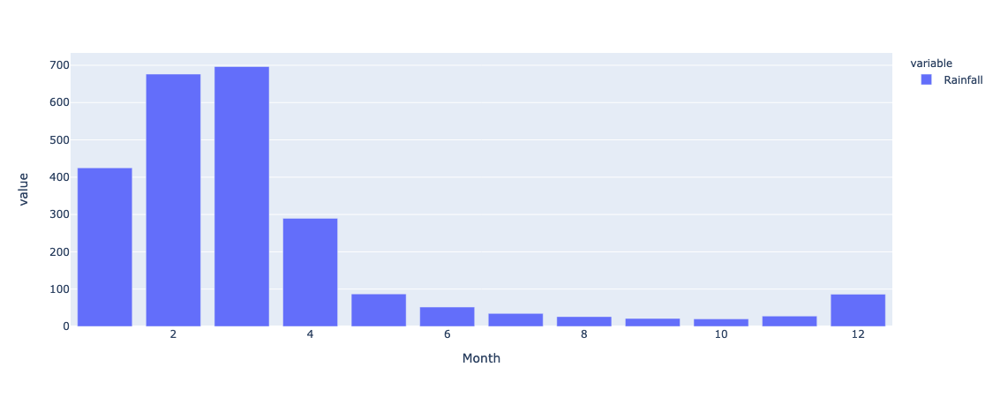

In [96]:
px.bar(monthly_averages)

In [100]:
rain_indexed['Year'] = rain_indexed.index.year

In [103]:
pivoted = rain_indexed.pivot_table(values='Rainfall', index='Month', columns='Year')

In [106]:
pivoted.T

Month,1,2,3,4,5,6,7,8,9,10,11,12
Year,,,,,,,,,,,,
1930,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.361288,80.722659,7.804947,26.376346
1931,471.724333,291.616613,87.355145,83.967331,23.875898,22.790419,12.871472,10.562234,8.169399,8.655457,9.788416,55.468399
1932,801.405296,157.178801,635.821158,51.201306,124.234125,46.563380,25.048185,20.731459,16.064669,12.081717,9.726948,77.001299
1933,106.308398,981.152526,158.151675,323.972399,99.996345,40.234078,26.374056,23.590302,20.277420,16.052354,48.877292,83.731833
1934,720.729639,1666.376272,1597.885102,164.470520,105.173476,75.786574,59.451649,45.696131,37.787448,28.758929,30.394668,18.526448
...,...,...,...,...,...,...,...,...,...,...,...,...
2003,72.400140,144.155741,265.254258,40.755336,22.802058,12.624559,10.237384,7.718140,5.574964,4.386521,3.900666,43.609516
2004,169.327018,937.087710,1972.888731,227.589131,163.178920,68.742185,53.474847,40.523823,33.708964,25.906666,21.667134,141.421164
2005,751.391996,163.581188,315.200881,75.694446,36.183504,28.693493,21.548346,20.202441,13.170252,10.767963,8.713725,16.182579


In [109]:
px.imshow?

Signature:
px.imshow(
    img,
    zmin=None,
    zmax=None,
    origin=None,
    labels={},
    x=None,
    y=None,
    animation_frame=None,
    facet_col=None,
    facet_col_wrap=None,
    facet_col_spacing=None,
    facet_row_spacing=None,
    color_continuous_scale=None,
    color_continuous_midpoint=None,
    range_color=None,
    title=None,
    template=None,
    width=None,
    height=None,
    aspect=None,
    contrast_rescaling=None,
    binary_string=None,
    binary_backend='auto',
    binary_compression_level=4,
    binary_format='png',
)
Docstring:
Display an image, i.e. data on a 2D regular raster.

Parameters
----------

img: array-like image, or xarray
    The image data. Supported array shapes are

    - (M, N): an image with scalar data. The data is visualized
      using a colormap.
    - (M, N, 3): an image with RGB values.
    - (M, N, 4): an image with RGBA values, i.e. including transparency.

zmin, zmax : scalar or iterable, optional
    zmin and zmax define t

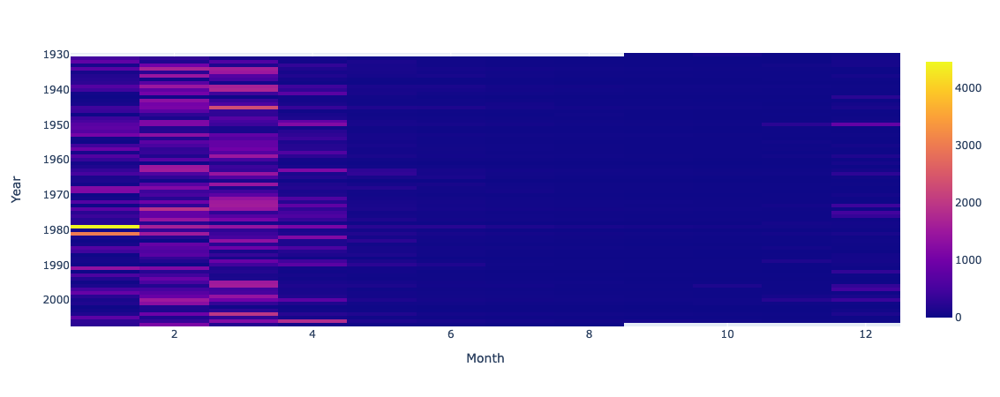

In [111]:
px.imshow(pivoted.T, aspect='auto')

### Examples of your time-series data and how you'd like to analyze it?

- Ben: rates and pressures from a well producing oil / gas. Maybe 20-30 years, maybe 1000s of wells. Live feed data that reports it in seconds. Much of Ben's day: filtering this data because the devices are in harsh environments / rugged constant use. So filtering the data is important so you can predict the future from past data.

Filtering: sensors could be in high-pressure / temperature environments or expensive to access. Hard to maintain. Extreme weather events. Offline for a number of days. Sometimes values are obviously wrong based on the physics.

With dodgy data:
- dropping (excluding) dodgy data
- sometimes filling it in (interpolation)

Maybe exlucde early / medium time when looking at late life ...

- Elmer: similar to what we've looked at already.

### Dropping dodgy data

#### Q: are any of the Rainfall values NaN (Not a Number)?

In [115]:
dodgy = rain_indexed['Rainfall'].isna()

In [117]:
dodgy.sum()   # True is 1, False is 0

0

In [126]:
apple_daily = apple.asfreq('D')
apple_daily[:15]

,Open,High,Low,Close,Volume,Adj Close,Jump,% Jump
Date,,,,,,,,
2000-01-03,104.87,112.50,101.69,111.94,19144400.0,27.74,7.07,0.067417
2000-01-04,108.25,110.62,101.19,102.50,18310000.0,25.40,-5.75,-0.053118
2000-01-05,103.75,110.56,103.00,104.00,27818000.0,25.77,0.25,0.002410
2000-01-06,106.12,107.00,95.00,95.00,27443200.0,23.54,-11.12,-0.104787
2000-01-07,96.50,101.00,95.50,99.50,16463200.0,24.66,3.00,0.031088
2000-01-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-01-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000-01-10,102.00,102.25,94.75,97.75,18059200.0,24.22,-4.25,-0.041667
2000-01-11,95.94,99.37,90.50,92.75,15775200.0,22.98,-3.19,-0.033250


In [127]:
dodgy2 = apple_daily['Close'].isna()

In [128]:
dodgy2.sum()

1473

Here's how we can exclude the rows with NaN values:

In [131]:
apple_daily.loc[~dodgy2]     # tilde: vectorized "not". Negates the mask.

,Open,High,Low,Close,Volume,Adj Close,Jump,% Jump
Date,,,,,,,,
2000-01-03,104.87,112.50,101.69,111.94,19144400.0,27.74,7.07,0.067417
2000-01-04,108.25,110.62,101.19,102.50,18310000.0,25.40,-5.75,-0.053118
2000-01-05,103.75,110.56,103.00,104.00,27818000.0,25.77,0.25,0.002410
2000-01-06,106.12,107.00,95.00,95.00,27443200.0,23.54,-11.12,-0.104787
2000-01-07,96.50,101.00,95.50,99.50,16463200.0,24.66,3.00,0.031088
...,...,...,...,...,...,...,...,...
2012-12-12,547.77,548.00,536.27,539.00,17398000.0,539.00,-8.77,-0.016010
2012-12-13,531.15,537.64,525.80,529.69,22330700.0,529.69,-1.46,-0.002749
2012-12-14,514.75,518.13,505.58,509.79,36056400.0,509.79,-4.96,-0.009636


Shortcut:

In [134]:
apple_daily.dropna(subset=['Close'])   # drops any rows with NaN values in the Close column

,Open,High,Low,Close,Volume,Adj Close,Jump,% Jump
Date,,,,,,,,
2000-01-03,104.87,112.50,101.69,111.94,19144400.0,27.74,7.07,0.067417
2000-01-04,108.25,110.62,101.19,102.50,18310000.0,25.40,-5.75,-0.053118
2000-01-05,103.75,110.56,103.00,104.00,27818000.0,25.77,0.25,0.002410
2000-01-06,106.12,107.00,95.00,95.00,27443200.0,23.54,-11.12,-0.104787
2000-01-07,96.50,101.00,95.50,99.50,16463200.0,24.66,3.00,0.031088
...,...,...,...,...,...,...,...,...
2012-12-12,547.77,548.00,536.27,539.00,17398000.0,539.00,-8.77,-0.016010
2012-12-13,531.15,537.64,525.80,529.69,22330700.0,529.69,-1.46,-0.002749
2012-12-14,514.75,518.13,505.58,509.79,36056400.0,509.79,-4.96,-0.009636


### Exercise

In [135]:
forbes = pd.read_csv('/Data/forbes.csv')

In [147]:
len(forbes)

1966

1. Set a useful index. (Hint: which column is a good label for the rest of the row?)

2. 4 companies didn't report profits (they are NaN). Which were they?
3. Try dropping those rows.

In [137]:
forbes_indexed = forbes.set_index('name')

In [141]:
no_reported_profits = forbes_indexed['profits'].isna()

#### Filtering data: using a Boolean mask (true / false values) for indexing gives you only those rows where the mask is true

In [145]:
forbes_indexed.loc[no_reported_profits]

,rank,country,sales,profits,assets,marketvalue
name,,,,,,
HHG,1085,United Kingdom,5.68,NaN,51.65,2.07
NTL,1091,United States,3.50,NaN,10.59,5.94
US Airways Group,1425,United States,5.50,NaN,8.58,0.24
Laidlaw International,1909,United States,4.48,NaN,3.98,1.49


In [148]:
no_dodgy = forbes_indexed.loc[~no_reported_profits]

In [151]:
# Shortcut:
no_dodgy = forbes_indexed.dropna(subset=['profits'])

In [150]:
len(no_dodgy)

1962

## Break until 11:10am

### Interpolating data

In [155]:
apple_daily['Adj Close'].interpolate()

Date
2000-01-03     27.740000
2000-01-04     25.400000
2000-01-05     25.770000
2000-01-06     23.540000
2000-01-07     24.660000
                 ...    
2012-12-14    509.790000
2012-12-15    512.803333
2012-12-16    515.816667
2012-12-17    518.830000
2012-12-18    533.900000
Freq: D, Name: Adj Close, Length: 4734, dtype: float64

In [158]:
import matplotlib.pyplot as plt

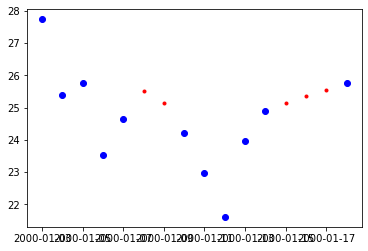

In [172]:
plt.plot(apple_daily['Adj Close'].interpolate(method='cubic')[:16], 'r.')
plt.plot(apple_daily['Adj Close'][:16], 'bo')

#### Filling data forward or backward into gaps

In [180]:
apple_daily['Adj Close'].ffill()[:16]

Date
2000-01-03    27.74
2000-01-04    25.40
2000-01-05    25.77
2000-01-06    23.54
2000-01-07    24.66
2000-01-08    24.66
2000-01-09    24.66
2000-01-10    24.22
2000-01-11    22.98
2000-01-12    21.61
2000-01-13    23.97
2000-01-14    24.89
2000-01-15    24.89
2000-01-16    24.89
2000-01-17    24.89
2000-01-18    25.76
Freq: D, Name: Adj Close, dtype: float64

In [175]:
apple_daily['Adj Close'].bfill()[:16]

Date
2000-01-03    27.74
2000-01-04    25.40
2000-01-05    25.77
2000-01-06    23.54
2000-01-07    24.66
2000-01-08    24.22
2000-01-09    24.22
2000-01-10    24.22
2000-01-11    22.98
2000-01-12    21.61
2000-01-13    23.97
2000-01-14    24.89
2000-01-15    25.76
2000-01-16    25.76
2000-01-17    25.76
2000-01-18    25.76
Freq: D, Name: Adj Close, dtype: float64

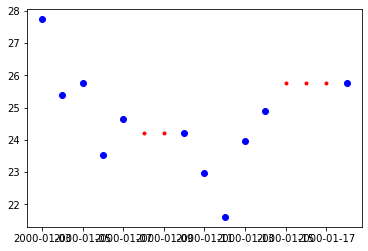

In [179]:
plt.plot(apple_daily['Adj Close'].bfill()[:16], 'r.')
plt.plot(apple_daily['Adj Close'][:16], 'bo')

### Later this afternoon: identifying dodgy data (outlier detection)

### Arrays

NumPy provides a powerful interface to arrays in one or more dimensions.


NumPy is written in C. It's fast. Foundational for Python data science.

In [182]:
import numpy as np    # np is a common abbreviation

In [183]:
# from numpy import sin, log, exp, array

### Creating arrays



In [184]:
list(range(10))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

In [186]:
a = np.arange(10)
a

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [189]:
b = np.arange(1, 5, 0.5)     # arguments are (start, stop, step)
b

array([1. , 1.5, 2. , 2.5, 3. , 3.5, 4. , 4.5])

In [190]:
c = np.linspace(-np.pi, np.pi, 5)    # (start, stop, num_points)
c

array([-3.14159265, -1.57079633,  0.        ,  1.57079633,  3.14159265])

In [192]:
x = np.linspace(-10, 10, num=1001)
x

array([-10.  ,  -9.98,  -9.96, ...,   9.96,   9.98,  10.  ])

In [193]:
y = x**2 * np.sin(x)

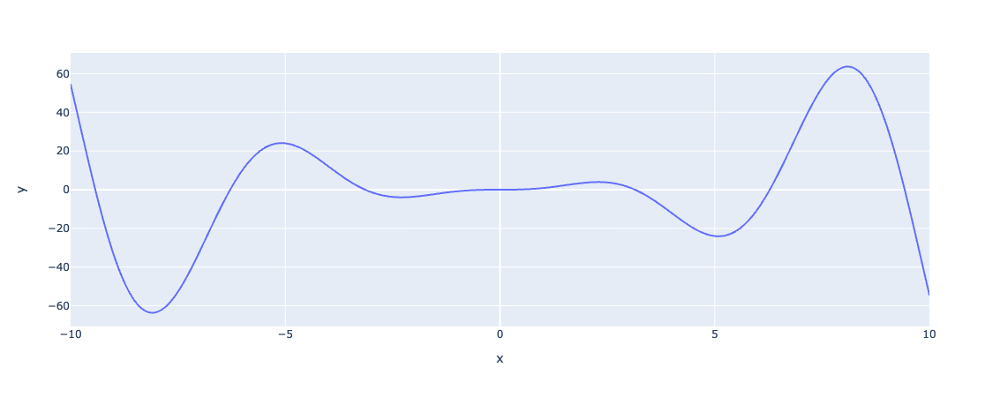

In [194]:
px.line(x=x, y=y)

In [195]:
np.diag([1, 2, 3])

array([[1, 0, 0],
       [0, 2, 0],
       [0, 0, 3]])

In [197]:
# diagonal with offset from the main diagonal
np.diag([1, 2, 3], k=2)

array([[0, 0, 1, 0, 0],
       [0, 0, 0, 2, 0],
       [0, 0, 0, 0, 3],
       [0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0]])

In [198]:
np.zeros((3, 3))

array([[0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.]])

In [200]:
np.ones((2, 5), dtype=np.int64)

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]])

In [201]:
np.identity(5)

array([[1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.]])

#### Creating an array from some arbitrary sequence (iterator)

In [208]:
heights = {'Ben': 1.83, 'Ed': 1.75, 'Pragathi': 1.7, 'Elmer': 1.78}

h = np.fromiter(heights.values(), float)   # or np.float64

h

array([1.83, 1.75, 1.7 , 1.78])

In [206]:
np.mean(h)

1.7650000000000001

### Examples of arrays representing images

In [209]:
elevation = plt.imread('/Data/spatial/elevation.tif')

In [210]:
elevation.shape

(1350, 1500, 4)

In [211]:
# Take band 0
band0 = elevation[:, :, 0]
band0.shape

(1350, 1500)

In [212]:
band0

array([[141, 141, 141, ...,  58,  58,  58],
       [142, 142, 142, ...,  58,  58,  58],
       [143, 143, 143, ...,  58,  58,  58],
       ...,
       [126, 126, 127, ...,  84,  84,  85],
       [126, 127, 127, ...,  84,  84,  85],
       [126, 127, 128, ...,  84,  84,  85]], dtype=uint8)

In [218]:
2**8 - 1

255

In [219]:
np.min(band0), np.max(band0)

(55, 156)

In [214]:
%config InlineBackend.figure_format='retina'

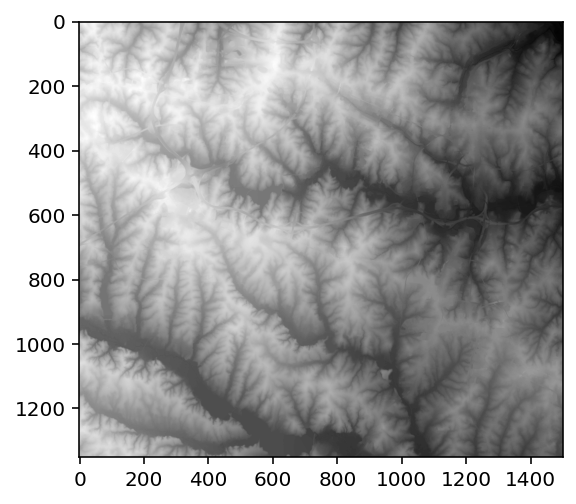

In [215]:
plt.imshow(band0, cmap='gray')

In [216]:
subset = band0[500:700, 1100:1300]

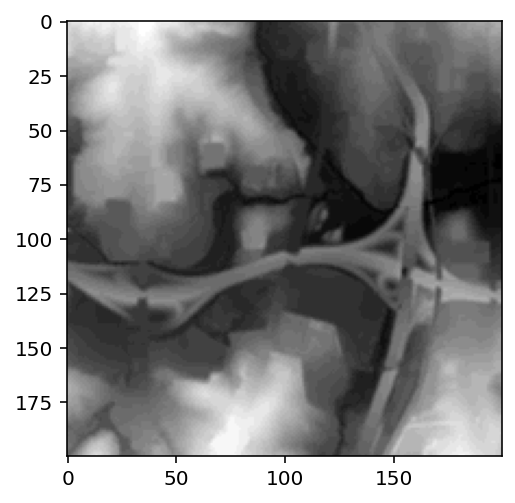

In [217]:
plt.imshow(subset, cmap='gray')

#### Summary: the important things to know about an array's structure are its shape and its data type:

In [222]:
band0.shape

(1350, 1500)

In [221]:
band0.dtype

dtype('uint8')

### Exercise

1. Read in this data:

In [223]:
balloon = plt.imread('/Data/hot-air-balloon1.jpg')

2. What is the shape of the `balloon` array? What does this mean?

Hint: colour images are often stored as RGB: with red, green, blue channels.

3. How many megapixels did the camera have?

4. What is the dtype of the array? How many bytes does it use in memory?

5. Use a slice to visualize just the basket under the hot air balloon.

### Extended exercise: find all "white" pixels

6. Create a grayscale image by calculating the mean pixel intensity across the red, green, and blue channels. (Hint: look at the docs for `np.mean?`)

Hint: you want to pass `axis=2` in order to average over just the colour channels.

7. Create a boolean mask for wherever the mean pixel intensity > 230

### Challenge exercise: change the man's shirt from white to yellow

### Solutions

In [224]:
balloon.shape

(1932, 2576, 3)

In [230]:
rows, columns, colour_depth = balloon.shape

Meaning: 3 matrices with 1932 rows x 2576 columns, one for each of the red, green, blue channels

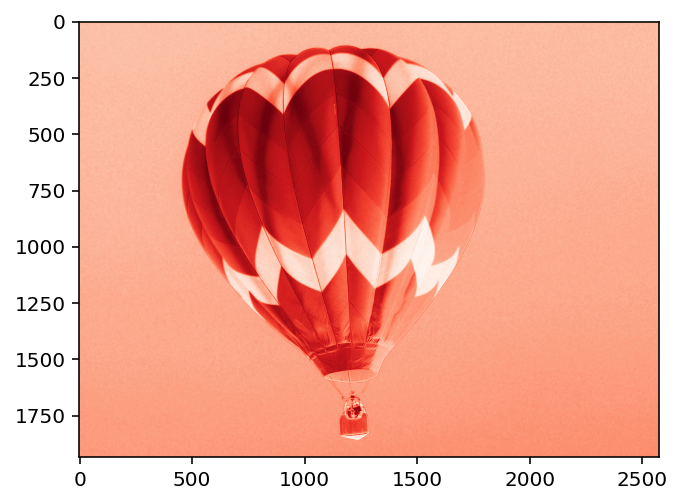

In [231]:
# Example:
plt.imshow(balloon[:, :, 0], cmap='Reds')

In [232]:
rows * columns

4976832

In [233]:
megapixels = rows * columns / 10**6
megapixels

4.976832

In [234]:
balloon.dtype 

dtype('uint8')

In [241]:
balloon.dtype.itemsize

1

Unsigned integers, 8 bits (i.e. never negative: 0 up to $2^8 - 1$)

In [236]:
np.min(balloon), np.max(balloon)

(0, 255)

Memory usage:

In [237]:
rows * columns * colour_depth

14930496

In [238]:
balloon.shape

(1932, 2576, 3)

In [240]:
np.product(balloon.shape) * balloon.dtype.itemsize

14930496

In [242]:
# Shortcut:
balloon.nbytes

14930496

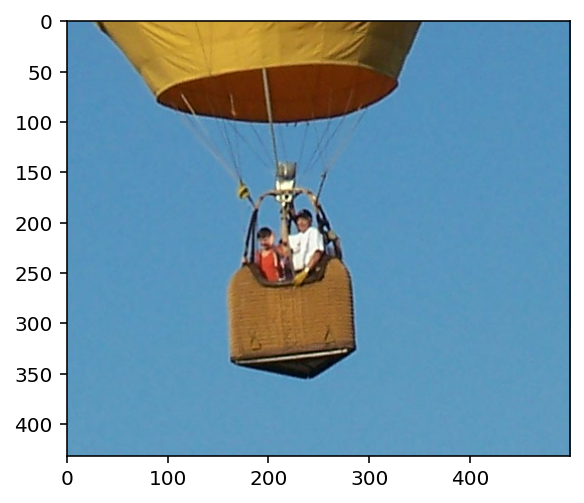

In [247]:
basket=balloon[1500:2000, 1000:1500]

plt.imshow(basket)

Extended exercise: find all "white" pixels

    Create a grayscale image by calculating the mean pixel intensity across the red, green, and blue channels. (Hint: look at the docs for np.mean?)

Hint: you want to pass axis=2 in order to average over just the colour channels.

In [250]:
grayscale = np.mean(basket, axis=2)

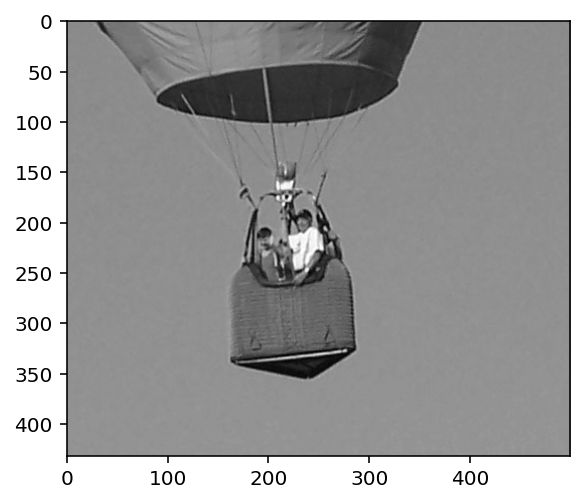

In [251]:
plt.imshow(grayscale, cmap='gray')

In [259]:
whites = grayscale > 220

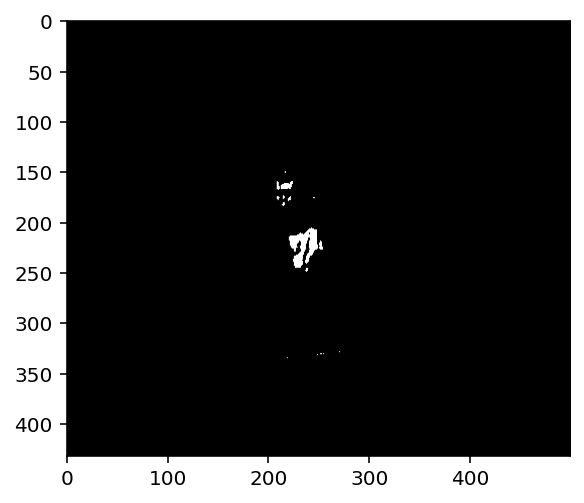

In [260]:
plt.imshow(whites, cmap='gray')

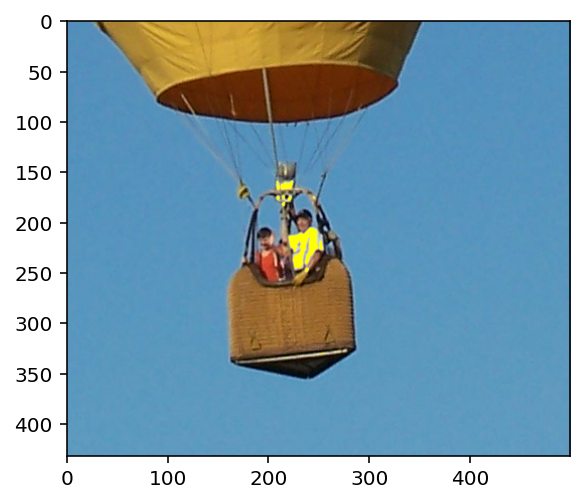

In [266]:
yellow = [255, 255, 0]

new_basket = basket.copy()

new_basket[whites] = yellow

plt.imshow(new_basket)

## Application of arrays to Monte Carlo simulation

Powerful technique for simulation.

Applications:

- optimization
- integration

Example: what is the probability of a certain event in the future?

e.g. what is the probability that Apple stock drops by at least 10% in a single day?

#### Example 1: estimate $\pi$

![](https://helloacm.com/wp-content/uploads/2015/11/Monte-Carlo01-300x300.jpg)

In [269]:
4 * 0.8

3.2

We can estimate the red-shaded area $\pi / 4$ as accurately as we like by sampling enough points in the square and counting what proportion of them are in the circle.

In [314]:
xs = np.random.uniform(size=10**5)

ys = np.random.uniform(size=10**5)

#### Question: is each point in the unit circle or not?

In [315]:
xs[0], ys[0]

(0.2100067738672342, 0.9486932255911269)

In [319]:
np.hypot(xs[0], ys[0]) < 1

True

In [318]:
# np.sqrt(xs[0]**2 + ys[0]**2)

In [326]:
in_circle = 0

for i in range(10**5):
    xi = xs[i]
    yi = ys[i]
    if np.hypot(xi, yi) < 1:
        in_circle += 1
        # same as this:
        # in_circle = in_circle + 1

In [327]:
in_circle

78336

So our estimate for $\pi$ is $4 \times $ the proportion of points that were in the circle.

In [328]:
4 * in_circle / 10**5

3.13344

#### Now in a "vectorized" way (without a `for` loop)

In [373]:
# np.sqrt(xs**2 + ys**2) < 1

In [372]:
np.hypot(xs, ys) < 1

array([ True, False,  True, ...,  True,  True,  True])

In [335]:
in_circle = np.hypot(xs, ys) < 1

np.sum(in_circle)

In [337]:
np.count_nonzero(in_circle)   # i.e. count the true values

78336

In [338]:
def monte_carlo_pi(n=10**5):
    xs = np.random.uniform(size=n)
    ys = np.random.uniform(size=n)
    in_circle = np.hypot(xs, ys) < 1
    proportion = np.sum(in_circle) / n
    return 4 * proportion

In [341]:
monte_carlo_pi(10**8)

3.1415968

### Example 2: investment simulator

> John and Jane want to save money to buy a house for their newborn son, Patrick. They want to have $850k saved by the time Patrick is finishing university 21 years from now.

> They are planning to save $20k each year (ignore taxes). Assume that the return each year is normally distributed (mean 6%, stdev 10%).

Run a simulation with at least 1000 trials.

(a) What is the probability that they will hit their savings goal?

### Extension

(b) How much money would they need to save each year to be 90% likely to hit their savings goal?

## Lunch until 1:20pm

In [342]:
mean_return = 0.06
std_return = 0.1
num_trials = 10**5
years = 21
savings_goal = 850_000

In [343]:
returns = np.random.normal(mean_return, std_return, size=years)

In [349]:
def savings(year):
    """
    Calculate savings at the end of the given year
    """
    if year == 0:
        return 20_000 * (returns[year] + 1)
    else:
        return (20_000 + savings(year - 1)) * (returns[year] + 1)

In [351]:
savings(year=0)

21781.52360740467

In [352]:
savings(year=1)

48765.68300358717

In [353]:
savings(year=20)

490809.3246854285

### Exercise

1. Use a `for` loop with 100,000 simulations to estimate the probability that the savings balance after year 20 > $850,000

### Solution

In [354]:
wins = 0

for trial in range(num_trials):
    returns = np.random.normal(mean_return, std_return, size=years)
    if savings(year=20) > savings_goal:
        wins += 1

In [356]:
wins / num_trials

0.43387

So we estimate they are 43% likely to hit their savings goal of $850,000.

#### Challenge exercise

2. Try doing this in a "vectorized" way (without a `for` loop).

In [359]:
returns = np.random.normal(mean_return, std_return, size=(years, num_trials))

In [360]:
returns.shape

(21, 100000)

```python
def savings(year):
    """
    Calculate savings at the end of the given year
    """
    if year == 0:
        return 20_000 * (returns[year] + 1)
    else:
        return (20_000 + savings(year - 1)) * (returns[year] + 1)
```

In [362]:
savings(0)

array([19020.34644235, 21045.76551459, 22350.40138072, ...,
       22885.58918772, 20321.59690395, 22834.39959542])

In [369]:
savings(1)

array([46342.71269602, 44491.53618749, 49335.34385913, ...,
       48295.40012942, 47202.87119498, 45198.32739802])

In [370]:
savings(year=20)

array([ 520499.48830181,  556879.97317614, 1286554.19287459, ...,
        881662.72282673, 1020429.42550671,  570680.66446169])

In [374]:
savings(year=20) > 850_000

array([False, False,  True, ...,  True,  True, False])

The proportion true is the sum divided by the number of trials

In [375]:
wins = savings(year=20) > 850_000
np.sum(wins) / num_trials

0.43554

In [376]:
# Shortcut
np.mean(wins)

0.43554

Trick: the mean of booleans (True / False) is the proportion that are True

### Questions?

## Statistics

In [379]:
abalone = pd.read_csv('/Data/abalone.csv')

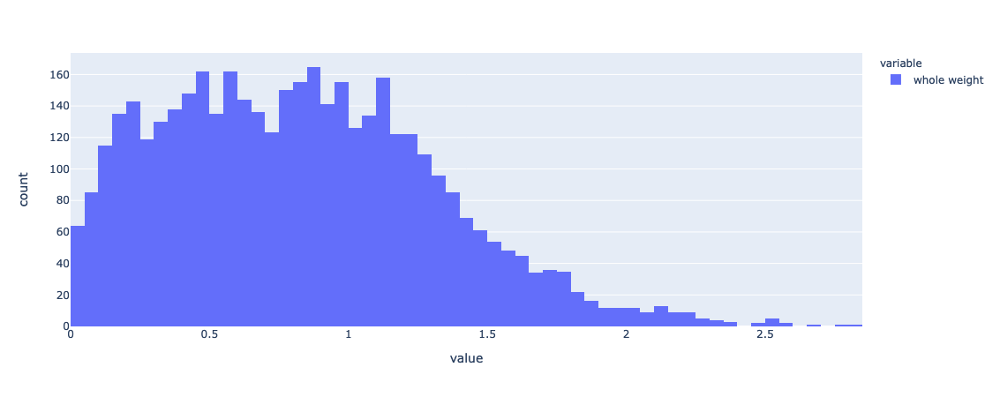

In [381]:
px.histogram(abalone['whole weight'])

In [383]:
from scipy.stats import norm, gamma, beta, uniform, expon

In [385]:
params = norm.fit(abalone['whole weight'])

In [387]:
params

(0.8287421594445774, 0.4903303136137728)

In [388]:
# model = norm(params[0], params[1])
# Shortcut:
model = norm(*params)

In [392]:
x = np.linspace(0, np.max(abalone['whole weight']), num=1001)

In [393]:
y = model.pdf(x)

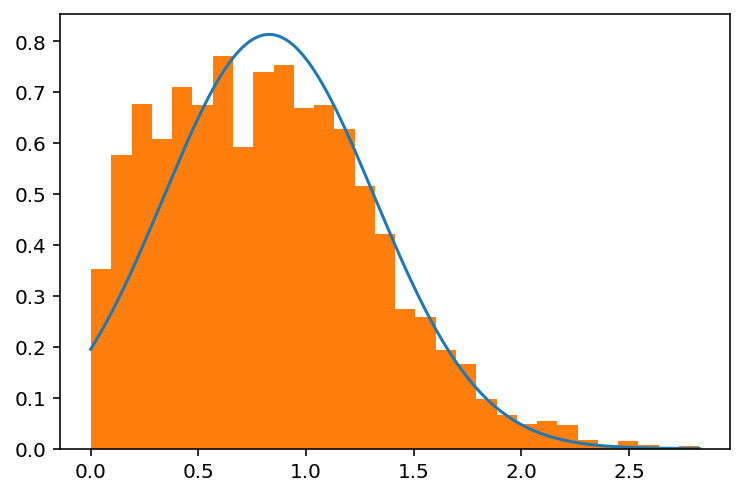

In [396]:
plt.plot(x, y)
plt.hist(abalone['whole weight'], bins=30, density=True);

### Exercise:

Use the same approach to fit these models and plot them together with the histogram of the real data:

- gamma
- beta
- expon
- uniform

Which one looks like the best fit?

### Solution

In [416]:
def create_model(dist, data):
    """
    Fit the given scipy.stats distribution to the given data
    and create a new model with those fitted parameters.
    """
    params = dist.fit(data)
    model = dist(*params)
    return model

In [423]:
def plot_model(model, data):
    """
    Plot the given model superimposed on a histogram of the data.
    """
    x = np.linspace(np.min(data), np.max(data), num=1001)
    y = model.pdf(x)
    plt.plot(x, y)
    plt.hist(data, bins=30, density=True);

In [417]:
w = abalone['whole weight']

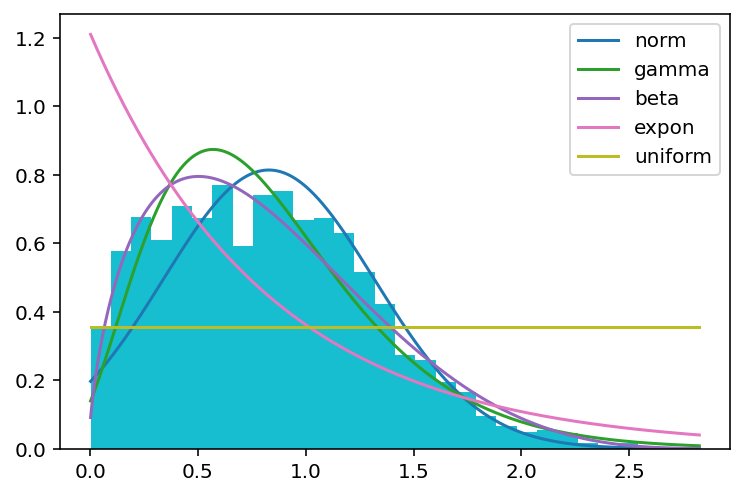

In [441]:
dists = [norm, gamma, beta, expon, uniform]
for dist in dists:
    plot_model(create_model(dist, w), w)
plt.legend(['norm', 'gamma', 'beta', 'expon', 'uniform'])

### Applications

### Example

Fit a log normal model to Apple's stock price % changes. What is the probability that the stock drops by more than 5% in a single day?

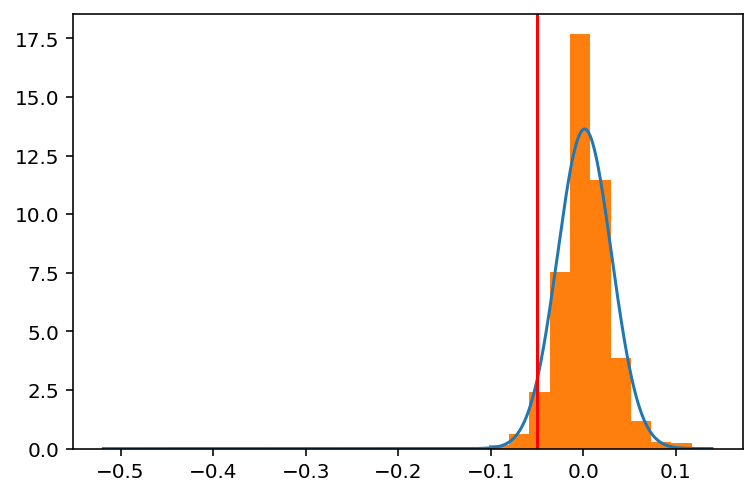

In [437]:
changes = apple['Adj Close'].pct_change().dropna()

from scipy.stats import lognorm

model_apple = create_model(lognorm, changes)

plot_model(model_apple, changes)
plt.axvline(x=-0.05, color='red')

In [431]:
model_apple.cdf(-0.05)

0.03975598212126354

### Exercise

What is the probability that Apple's stock prices increases by 5% **or more** in a single day under this lognormal model?

i.e. the area under the blue density between the red line and positive infinity:

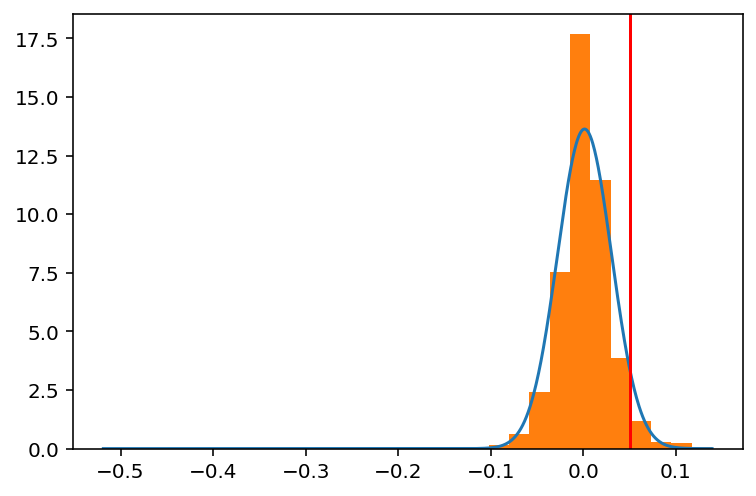

In [438]:
plot_model(model_apple, changes)
plt.axvline(x=0.05, color='red')

### Solution

In [440]:
1 - model_apple.cdf(0.05)

0.048037087261592615

Answer: 4.8%

### Nonparametric modelling

Caution: if you don't have reason to believe that a particular parametric form is present, try nonparametric modelling methods instead.

In [8]:
import pandas as pd

portfolio = pd.read_hdf('~/Data/portfolio_flat.h5')

In [9]:
stocks = ['AAPL', 'GOOG']
changes = portfolio.swaplevel(axis=1)['Adj Close'][stocks].pct_change().dropna()

These are both related (both tech stocks) so it doesn't make sense to assume they are independent.

Also, if the price changes were normally distributed, we could use a multivariate normal model like `scipy.stats.mvn` -- but we don't have reason to believe stock price changes are normally distributed. (They're not: they have fatter tails ...)

Now what?

We'll use a **nonparametric** modelling approach instead. Nonparametric methods don't assume any parametric form in advance but attempt to fit to the actual data, like a smoothed version of a histogram.

In [10]:
from sklearn.mixture import GaussianMixture

model_apple_google = GaussianMixture(n_components=5)

Tomorrow you'll see how to optimize parameters like the `5` above for ML models.

In [11]:
model_apple_google.fit(changes)

GaussianMixture(n_components=5)

Unfinished in class. **Continued here:**

Let's visualise the model first as a density surface:

In [59]:
import numpy as np

x = np.linspace(changes['AAPL'].min() * 1.1, changes['AAPL'].max() * 1.1, num=500)
y = np.linspace(changes['GOOG'].min() * 1.1, changes['GOOG'].max() * 1.1, num=500)

In [60]:
X, Y = np.meshgrid(x, y)

In [61]:
xy = np.vstack([X.ravel(), Y.ravel()]).T
xy.shape

(250000, 2)

This computes the log likelihood, i.e. $\log(\text{pdf}(x))$:

In [ ]:
loglik = model_apple_google.score_samples(xy)

So the probability density function $p(x, y)$ in the double integral above is given by:

In [109]:
def p(x, y):
    xy = np.vstack([np.ravel(x), np.ravel(y)]).T
    return np.exp(model_apple_google.score_samples(xy))

In [117]:
pdf = p(xy[:, 0], xy[:, 1])
Z = pdf.reshape(X.shape)

In [63]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y)])

In [64]:
fig



### Challenge exercise

**What is the probability that both Apple and Google drop by 5% or more in a single day?**

The answer to this question is the volume under the Gaussian Mixture probability denstiy curve from $-\infty$ to $-0.05$ in both axes.

Try calculating this volume $\int_{-\infty}^{-.05}\int_{-\infty}^{-.05} p(x, y) \text{d}x \text{d}y$,

where $p(x, y)$ is the probability density function given above.

Idea: you can compute double integrals using the `dblquad` function from `scipy.integrate`:

In [50]:
from scipy.integrate import dblquad

dblquad?

#### Approximate answer with kernel density estimation

In [122]:
from scipy.stats import gaussian_kde

model2_apple_google = gaussian_kde(changes.T)

model2_apple_google.integrate_box([-np.inf, -np.inf], [-0.05, -0.05])

0.006235571054568624

i.e. about 0.62%.

## Regression

- Ben: using Excel charting

With 1 variable:

$y = mx + c$

With multiple variables:

$y = m_1 x_1 + m_2 x_2 + ... + c$

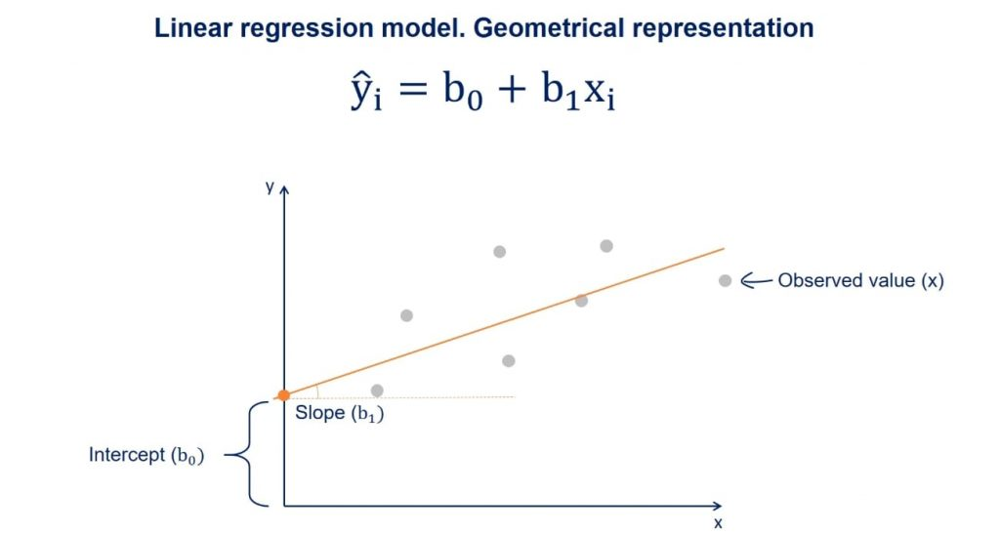

In [462]:
calories = pd.read_csv('/Data/calories_clean.csv')
calories[:3]

,Food,Measure,Weight,kCal,Fat,Carbo,Protein
0,"1000 Island,Salad Drsng,Local",1 Tbsp,15.00,25,2,2,0
1,"1000 Island,Salad Drsng,Reglr",1 Tbsp,16.00,60,6,2,0
2,"40% Bran Flakes,Kellogg's",1 oz,28.35,90,1,22,4


#### Question: how many kCal are in 1 gram of fat, carbs or protein?

#### We'll use Statsmodels here

In [463]:
from statsmodels.formula.api import ols    # ordinary least squares

In [467]:
model_calories = ols('kCal ~ Fat + Carbo + Protein - 1', calories).fit()

In [468]:
model_calories.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                   kCal   R-squared (uncentered):                   0.999
Model:                            OLS   Adj. R-squared (uncentered):              0.999
Method:                 Least Squares   F-statistic:                          3.168e+05
Date:                Wed, 24 Nov 2021   Prob (F-statistic):                        0.00
Time:                        03:56:42   Log-Likelihood:                         -4200.8
No. Observations:                 960   AIC:                                      8408.
Df Residuals:                     957   BIC:                                      8422.
Df Model:                           3                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Fat            8.7877      0.022    394.641      0.000       8.744       8.831
Carbo          3.8380      0.010    368.627      0.000       3.818       3.858
Protein        4.2280      0.067     62.660      0.000       4.096       4.360
==============================================================================
Omnibus:                      773.259   Durbin-Watson:                   1.605
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           107035.242
Skew:                          -2.890   Prob(JB):                         0.00
Kurtosis:                      54.405   Cond. No.                         9.68
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [469]:
model_calories.params

Fat        8.787743
Carbo      3.837994
Protein    4.228039
dtype: float64

#### Applications: prediction

In [470]:
big_mac = {'Fat': 30, 'Carbo': 45, 'Protein': 25}

In [471]:
model_calories.predict(big_mac)

0    542.042991
dtype: float64

In [472]:
30 * 8.787743 + 45 * 3.837994 + 25 * 4.228039

542.042995

### Exercise

1. Look up nutritional stats on a few foods
2. Use your fitted model to predict how many kCal there are for each of your foods.

### Solution

In [473]:
zinger_burger = {'Fat':19.2, 'Carbo':44.7, 'Protein':28.7}
pizza_meatlover = {'Fat':8, 'Carbo':38, 'Protein':11}
subway_6_buff_chick= {'Fat': 4.1, 'Carbo': 41.4, 'Protein': 23.1}

In [477]:
foods = pd.DataFrame(
    [big_mac, zinger_burger, pizza_meatlover, subway_6_buff_chick],
    index=['big_mac', 'zinger_burger', 'pizza_meatlover', 'subway_6_buff_chick']
)
foods

,Fat,Carbo,Protein
big_mac,30.0,45.0,25.0
zinger_burger,19.2,44.7,28.7
pizza_meatlover,8.0,38.0,11.0
subway_6_buff_chick,4.1,41.4,23.1


In [478]:
model_calories.predict(foods)

big_mac                542.042991
zinger_burger          461.627710
pizza_meatlover        262.654144
subway_6_buff_chick    292.590392
dtype: float64

### Questions about linear regression?

### Summary:

- You can fit regression models quite easily using Statsmodels
- You can use these to make predictions using the `.predict()` method.

### Break until 3:30pm

### Topic requests

- Outlier detection
- Clustering
- Graphical interfaces / dashboards

## Outlier detection

PyOD package: https://pyod.readthedocs.io/en/latest/

In [479]:
pedestrians = pd.read_hdf('/Data/pedestrians_flat.h5')

In [480]:
pedestrians

Time,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Date_Time,,,,,,,,,,,,,,,,,,,,,
2018-01-01,895,890,435,299,181,87,59,107,109,312,...,2897,2919,2898,2521,2096,1585,879,761,325,153
2018-01-02,73,53,19,19,24,38,72,232,445,646,...,3175,3152,3126,2957,2392,1668,849,534,328,211
2018-01-03,84,67,21,24,6,20,102,272,507,858,...,3492,3345,3375,3449,2689,1915,1082,822,516,216
2018-01-04,107,77,32,23,50,44,105,277,654,888,...,3538,3379,3189,3274,2519,2089,1739,1113,478,278
2018-01-05,152,52,52,32,36,15,125,286,593,853,...,3290,3368,3299,3509,3107,2489,2251,1583,873,500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-27,170,67,39,13,23,52,94,190,536,1025,...,2872,2725,2635,2478,2228,1916,2113,1624,886,303
2018-12-28,155,93,90,26,30,25,71,156,460,840,...,3094,3092,2623,2358,2450,1815,2043,1724,879,430
2018-12-29,223,130,81,39,52,52,44,104,326,707,...,2874,2862,2717,2434,2359,2237,1527,1009,641,375


These represent pedestrian traffic counts at Bourke Street Mall (North intersection) in Melbourne CBD in 2018.

#### Don't type this:

In [482]:
# ped_larger = pd.read_csv('/Data/pedestrians_2018.csv.gz')
# ped_larger

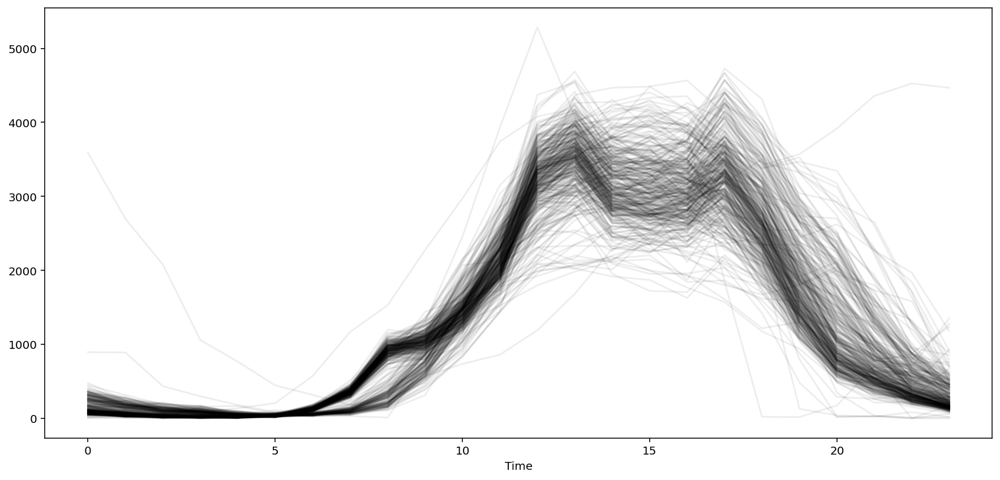

In [484]:
pedestrians.T.plot(color='black', alpha=0.07, legend=False, figsize=(15, 7));

In [485]:
from pyod.models.knn import KNN

In [509]:
model_outliers = KNN(contamination=0.05)

In [510]:
model_outliers.fit(pedestrians)

KNN(algorithm='auto', contamination=0.05, leaf_size=30, method='largest',
  metric='minkowski', metric_params=None, n_jobs=1, n_neighbors=5, p=2,
  radius=1.0)

In [511]:
outliers = model_outliers.predict(pedestrians) == 1

# outliers

pedestrians.loc[outliers]

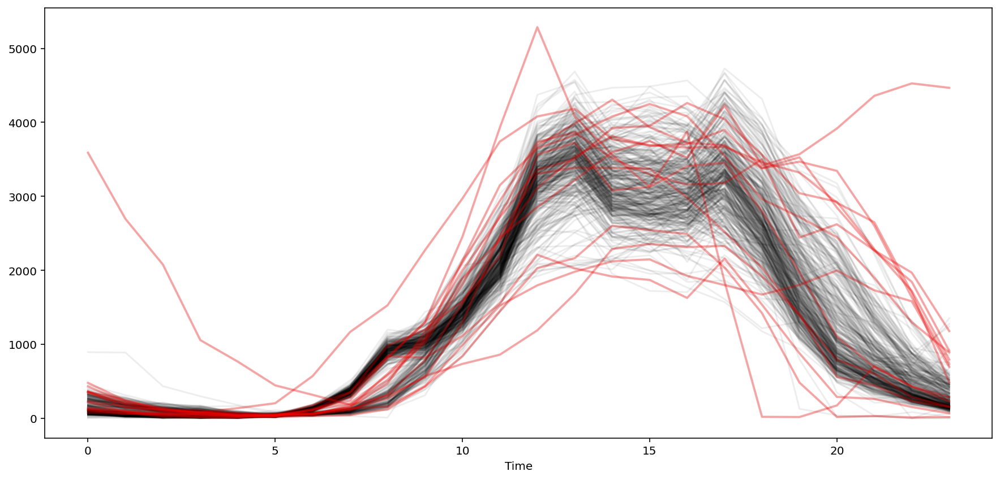

In [513]:
ax = pedestrians.T.plot(color='black', alpha=0.07, legend=False, figsize=(15, 7))
pedestrians.loc[outliers].T.plot(color='red', alpha=0.3, legend=False, linewidth=2, ax=ax);

### Exercise

1. Try this, with different `contamination` ratios (e.g. 0.05, 0.01).

2. Try some other algorithms, e.g. ABOD:

In [495]:
from pyod.models.abod import ABOD

In [514]:
model_outliers_2 = ABOD(contamination=0.01)

### Solution

In [515]:
model_outliers_2.fit(pedestrians.astype(float))

ABOD(contamination=0.01, method='fast', n_neighbors=5)

In [516]:
outliers = model_outliers_2.predict(pedestrians) == 1

# outliers

pedestrians.loc[outliers]

Time,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Date_Time,,,,,,,,,,,,,,,,,,,,,
2018-02-17,344,201,100,83,36,54,50,111,324,787,...,3600,3748,3522,4233,3418,3570,3917,4359,4527,4467
2018-02-18,3590,2696,2079,1058,767,446,318,183,306,556,...,3386,3374,2982,2520,2035,1391,793,605,288,160
2018-11-09,113,61,66,53,42,36,113,346,980,1201,...,3082,3131,3875,1846,21,18,175,708,430,288
2018-12-26,231,161,74,83,138,205,572,1168,1528,2273,...,3771,3693,3659,3669,3461,3322,2914,2650,1701,486


### Questions?

### Note

There is some subjectivity in the definition of an outlier. The 40+ algorithms in PyOD use different defintions. Try a consensus approach.

## Clustering

- Ben: properties of a rock, pressure ... be predictive of the performance of a well. Grouping a number of wells into clusters could help with predicting the performance.

In [520]:
cars_indexed = cars.set_index('name').drop(columns=['Unnamed: 0'])
cars_indexed[:3]

,mpg,cylinders,displacement,horsepower,weight,acceleration,year,origin
name,,,,,,,,
chevrolet chevelle malibu,18.0,8,307.0,130,3504,12.0,70,1
buick skylark 320,15.0,8,350.0,165,3693,11.5,70,1
plymouth satellite,18.0,8,318.0,150,3436,11.0,70,1


In [528]:
from sklearn.cluster import KMeans

model_cars = KMeans(n_clusters=3)

model_cars.fit(cars_indexed)

KMeans(n_clusters=3)

In [526]:
cars_indexed['cluster'] = model_cars.predict(cars_indexed)

In [533]:
cars_indexed[:3]

,mpg,cylinders,displacement,horsepower,weight,acceleration,year,origin,cluster
name,,,,,,,,,
chevrolet chevelle malibu,18.0,8,307.0,130,3504,12.0,70,1,0
buick skylark 320,15.0,8,350.0,165,3693,11.5,70,1,2
plymouth satellite,18.0,8,318.0,150,3436,11.0,70,1,0


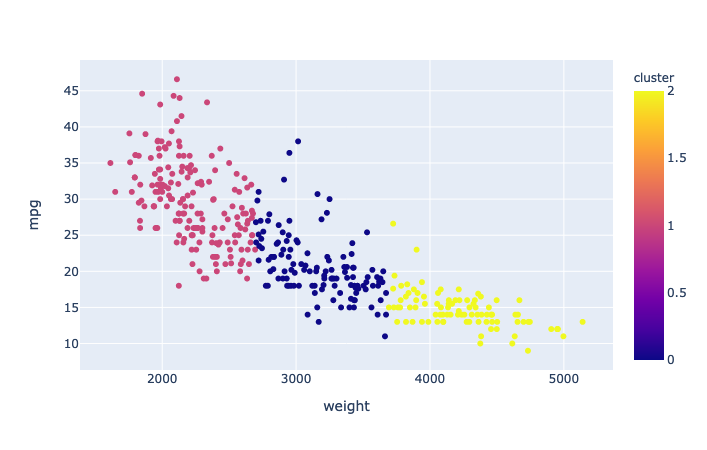

In [532]:
px.scatter(cars_indexed, x='weight', y='mpg', color='cluster')

### Further clustering example: clustering in colour space

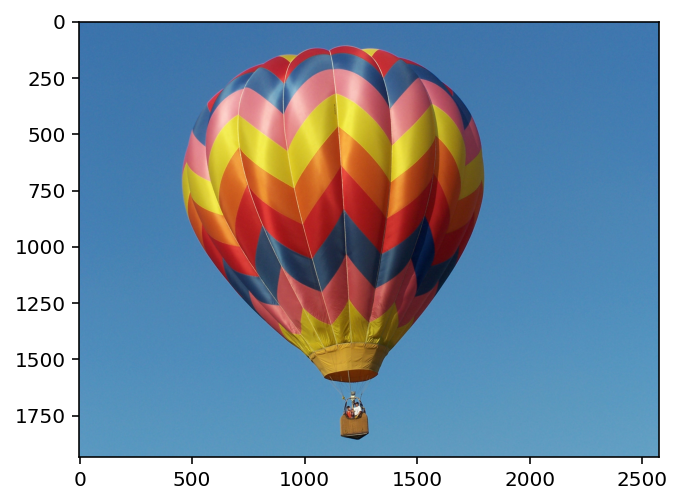

In [534]:
plt.imshow(balloon)

Scikit-Learn requires "tidy data":
- rows are observations
- columns are features

In [537]:
balloon.shape

(1932, 2576, 3)

In [539]:
rows, columns, colour_depth = balloon.shape

In [541]:
balloon_flat = np.reshape(balloon, (rows * columns, 3))
balloon_flat.shape

(4976832, 3)

In [542]:
balloon_flat

array([[ 60, 112, 170],
       [ 60, 112, 170],
       [ 60, 112, 170],
       ...,
       [100, 160, 197],
       [101, 161, 198],
       [102, 162, 199]], dtype=uint8)

In [535]:
from sklearn.cluster import MiniBatchKMeans

In [543]:
model_balloon = MiniBatchKMeans(n_clusters=5)

In [544]:
model_balloon.fit(balloon_flat)

MiniBatchKMeans(n_clusters=5)

In [545]:
clusters = model_balloon.predict(balloon_flat)

In [546]:
clusters

array([4, 4, 4, ..., 1, 1, 1], dtype=int32)

In [551]:
palette = model_balloon.cluster_centers_.astype(int)

In [552]:
palette

array([[167,  68,  40],
       [ 84, 145, 187],
       [218, 168,  87],
       [ 60,  43,  52],
       [ 67, 122, 173]])

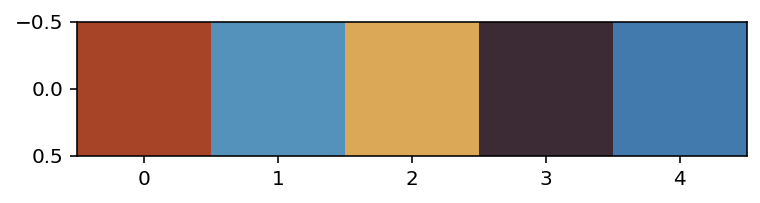

In [550]:
plt.imshow(pallette.reshape(1, 5, 3))

In [554]:
new_balloon = np.take(palette, clusters, axis=0)
new_balloon.shape

(4976832, 3)

In [558]:
256**3

16777216

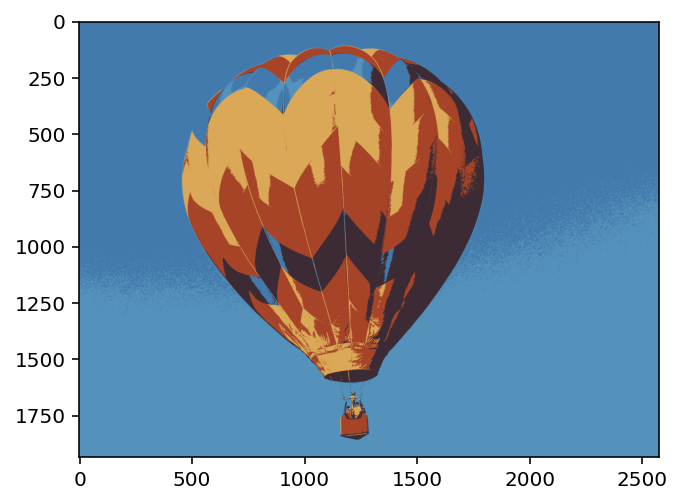

In [557]:
new_image = np.reshape(new_balloon, (rows, columns, 3))

plt.imshow(new_image)

### Summary

- You can cluster any data with scikit-learn provided you reshape it first to be 2d (rows=observations x columns=features) in "tidy format".

- Clusters are not unique. Different algorithms (and differents runs with the same algorithms) produce (hopefully small) differences.

https://scikit-learn.org/stable/auto_examples/cluster/plot_cluster_comparison.html

## Dashboards / GUIs

These days the easiest tool for creating GUIs & dashboards is Streamlit: https://streamlit.io/

Check out the demo apps in the gallery: https://streamlit.io/gallery

In [559]:
!pip install --upgrade streamlit

  Using cached streamlit-1.2.0-py2.py3-none-any.whl (9.1 MB)
Processing /home/data/.cache/pip/wheels/24/6f/0b/da9f81234859a8741aaea3afcc6ae2daf0efb67e7ff2d3686c/Pympler-0.9-py3-none-any.whl
  Attempting uninstall: streamlit
    Found existing installation: streamlit 0.75.0
    Uninstalling streamlit-0.75.0:
      Successfully uninstalled streamlit-0.75.0


In [561]:
%%writefile mydashboard.py
"""
Simple dashboard example using Streamlit
"""

import streamlit as st

st.write('# Cool dashboard')

name = st.text_input('Your name:')
st.write(f'Hello {name}!')

Overwriting mydashboard.py


Next:

1. Launch a Terminal (File | New | Terminal)
2. Type `streamlit run mydashboard.py`

This runs a web server on our cloud infrastructure (or your computer) listening on the port 8501 by default

3. Visit this URL in your browser:

https://hub.pythoncharmers.com/hub/user-redirect/proxy/8501/

### Exercise

Load this data:

In [637]:
ped_all = pd.read_csv(
    '/Data/pedestrians_2018.csv.gz',
    parse_dates=['Date_Time']
)

In [638]:
ped_all[:3]

,ID,Date_Time,Year,Month,Mdate,Day,Time,Sensor_ID,Sensor_Name,Hourly_Counts
0,2079938,2018-01-01,2018,January,1,Monday,0,1,Bourke Street Mall (North),895
1,2079939,2018-01-01,2018,January,1,Monday,0,2,Bourke Street Mall (South),734
2,2079940,2018-01-01,2018,January,1,Monday,0,3,Melbourne Central,2996


2. Extract all the unique sensor names like this:

In [572]:
sensors = ped_all['Sensor_Name'].unique()

3. Modify your dashboard code to offer a select box for a user to select a sensor.

Tip: look here: https://docs.streamlit.io/library/api-reference/widgets/st.selectbox

In [640]:
%%writefile mydashboard.py
"""
Simple dashboard example using Streamlit
"""

import streamlit as st

st.write('# Pedestrian traffic analysis')

import pandas as pd
ped_all = pd.read_csv(
    '/Data/pedestrians_2018.csv.gz',
    parse_dates=['Date_Time']
)
sensors = ped_all['Sensor_Name'].unique()

sensor = st.selectbox('Choose a sensor', sensors)
st.write(f'You chose {sensor}')

Overwriting mydashboard.py


4. Filter the rows to only one sensor and display only those rows.

In [641]:
sensor = 'Webb Bridge'

In [642]:
mask = (ped_all['Sensor_Name'] == sensor)
subset = ped_all.loc[mask]

In [643]:
subset

,ID,Date_Time,Year,Month,Mdate,Day,Time,Sensor_ID,Sensor_Name,Hourly_Counts
7,2079945,2018-01-01,2018,January,1,Monday,0,8,Webb Bridge,605
53,2079991,2018-01-01,2018,January,1,Monday,1,8,Webb Bridge,261
99,2080037,2018-01-01,2018,January,1,Monday,2,8,Webb Bridge,122
145,2080083,2018-01-01,2018,January,1,Monday,3,8,Webb Bridge,57
191,2080129,2018-01-01,2018,January,1,Monday,4,8,Webb Bridge,20
...,...,...,...,...,...,...,...,...,...,...
429829,2509767,2018-12-31,2018,December,31,Monday,19,8,Webb Bridge,349
429879,2509817,2018-12-31,2018,December,31,Monday,20,8,Webb Bridge,412
429929,2509867,2018-12-31,2018,December,31,Monday,21,8,Webb Bridge,491
429979,2509917,2018-12-31,2018,December,31,Monday,22,8,Webb Bridge,596


### Extended exercise

5. Plot the pedestrian traffic for that subset as we did before, showing which days were outliers.

Hint: you'll want a pivot table to get the hourly counts:

In [644]:
hourly_counts = subset.set_index(
    'Date_Time'
).pivot_table(
    index=pd.Grouper(freq='D'),
    columns='Time',
    values='Hourly_Counts'
).dropna()

In [645]:
hourly_counts

Time,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Date_Time,,,,,,,,,,,,,,,,,,,,,
2018-01-01,605,261,122,57,20,17,13,30,50,97,...,281,230,258,244,211,147,140,114,51,42
2018-01-02,14,8,10,3,2,26,60,172,280,184,...,317,280,366,399,254,155,103,104,47,25
2018-01-03,8,3,0,2,1,22,84,167,270,173,...,347,278,363,426,292,183,163,143,81,25
2018-01-04,17,2,2,1,2,28,89,180,308,180,...,330,271,344,433,233,193,163,126,64,42
2018-01-05,21,4,1,2,4,20,68,175,288,170,...,291,265,342,327,237,179,139,175,84,83
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-27,26,13,4,6,1,13,54,139,187,206,...,272,232,275,217,224,158,151,145,104,51
2018-12-28,22,5,4,1,5,19,49,122,160,167,...,266,227,231,290,266,218,209,156,134,79
2018-12-29,24,20,4,5,1,14,23,44,61,133,...,291,280,294,262,335,144,139,96,148,60


In [485]:
from pyod.models.knn import KNN

In [509]:
model_outliers = KNN(contamination=0.05)

In [510]:
model_outliers.fit(pedestrians)

KNN(algorithm='auto', contamination=0.05, leaf_size=30, method='largest',
  metric='minkowski', metric_params=None, n_jobs=1, n_neighbors=5, p=2,
  radius=1.0)

In [511]:
outliers = model_outliers.predict(pedestrians) == 1

# outliers

pedestrians.loc[outliers]

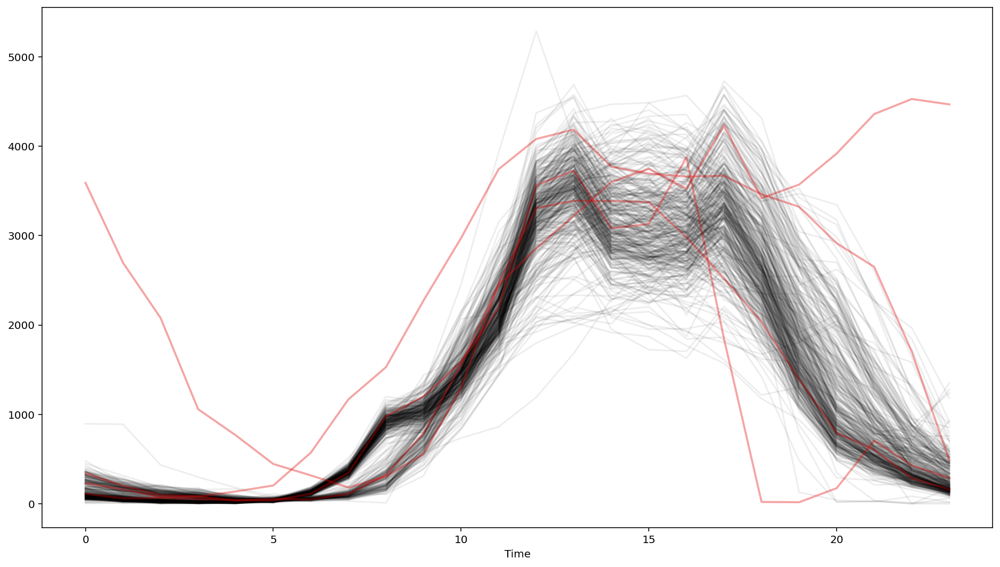

In [609]:
fig, ax = plt.subplots(figsize=(16, 9))
ax = pedestrians.T.plot(color='black', alpha=0.07, legend=False, ax=ax)
thing = pedestrians.loc[outliers].T.plot(color='red', alpha=0.3, legend=False, linewidth=2, ax=ax);

### Solution

Tip: separate your calculation / analytics / plotting code from your Streamlit GUI code.

Why?

1. Easier to test and debug in Jupyter
2. Easier to swap to a different GUI toolkit later (e.g. Plotly Dash) if you need to.

In [659]:
%%writefile calc.py

import pandas as pd
from pyod.models.knn import KNN
import matplotlib.pyplot as plt

ped_all = pd.read_csv(
    '/Data/pedestrians_2018.csv.gz',
    parse_dates=['Date_Time']
)

def get_sensors():
    sensors = ped_all['Sensor_Name'].unique()
    return sensors

def get_subset(sensor):
    mask = (ped_all['Sensor_Name'] == sensor)
    subset = ped_all.loc[mask]
    return subset

def get_hourly_counts(subset):
    # Pivot and drop missing (NaN) values:
    hourly_counts = subset.set_index(
        'Date_Time'
    ).pivot_table(
        index=pd.Grouper(freq='D'),
        columns='Time',
        values='Hourly_Counts'
    ).dropna()
    return hourly_counts

def detect_outliers(hourly_counts, contamination=0.05):
    model_outliers = KNN(contamination=contamination)
    model_outliers.fit(hourly_counts)
    outliers = model_outliers.predict(hourly_counts) == 1
    return outliers

def pretty_dates(timestamps):
    """
    Return a pretty Markdown-formatted list of dates
    (excluding times of the day).
    """
    dates = [ts.strftime('%d %B %Y') for ts in timestamps]
    return '\n'.join('- ' + date for date in dates)
    
def plot_hourly_counts_and_outliers(hourly_counts, outliers):
    fig, ax = plt.subplots(figsize=(16, 9))
    ax = hourly_counts.T.plot(color='black', alpha=0.07, legend=False, ax=ax)
    hourly_counts.loc[outliers].T.plot(color='red', alpha=0.3, legend=False, linewidth=2, ax=ax);
    return fig

Overwriting calc.py


In [664]:
%%writefile mydashboard.py
"""
Simple dashboard example using Streamlit
"""
import streamlit as st
import calc

st.write('# Pedestrian traffic analysis')

sensors = calc.get_sensors()

sensor = st.selectbox('Choose a sensor', sensors)
st.write(f'### ' + sensor)

### Display those rows of the dataframe

subset = calc.get_subset(sensor)
st.write(subset)

hourly_counts = calc.get_hourly_counts(subset)

st.write('### Outliers')

contamination = st.slider('What proportion of data are outliers?', min_value=0.01, max_value=0.1)
outliers = calc.detect_outliers(hourly_counts, contamination)
st.write('These days were outliers:\n', calc.pretty_dates(hourly_counts.index[outliers]))

fig = calc.plot_hourly_counts_and_outliers(hourly_counts, outliers)
st.write(fig)

Overwriting mydashboard.py


### Summary

Streamlit makes it pretty easy to create GUIs & dashbaords.

You can deploy it to the web, intranet, or your local computer.

Many input widgets and output widgets (maps, dataframes, chart types ...)

